In [2]:
import json
import os

import matplotlib.pyplot as plt
import monai
import pandas as pd
from tqdm import tqdm
from monai.data import MetaTensor

tqdm.pandas()
%matplotlib inline

In [4]:
df = pd.read_csv(
    "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0042021/participants.tsv", sep="\t"
)

In [6]:
source_path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0042021/"

data_list = []

for sub in df.participant_id:
    sessions = [
        f
        for f in os.listdir(os.path.join(source_path, sub))
        if "ses" in f and ".tsv" not in f
    ]
    for ses in sessions:
        mod_path = os.listdir(os.path.join(source_path, sub, ses, "mim-mr" ))
        for m in mod_path:
            images = [
                f
                for f in os.listdir(os.path.join(source_path, sub, ses, "mim-mr", m))
                if ".nii.gz" in f
            ]
            for img in images:
                row = {
                    "subject": sub,
                    "session": ses,
                    "modality": m,
                    "image": img,
                }
                data_list.append(row)

new_df = pd.DataFrame(data_list)

In [7]:
def get_img_info(row):
    image_name = row["image"]
    if "ax" in image_name:
        orientation = "ax"
    if "cor" in image_name:
        orientation = "cor"
    if "sag" in image_name:
        orientation = "sag"

    sequence = image_name.split("_")[-1].split(".")[0]

    return pd.Series({"orientation": orientation, "sequence": sequence})


new_df[["orientation", "sequence"]] = new_df.apply(get_img_info, axis=1)

In [9]:
new_df

,subject,session,modality,image,orientation,sequence
0,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-3_bp-prostat...,sag,T2w
1,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-8_bp-prostat...,ax,T2w
2,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-4_bp-prostat...,cor,stir
3,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-6_bp-prostat...,ax,T2w
4,sub-000063,ses-000063,dwi,sub-000063_ses-000063_acq-bvalue_run-13_bp-pro...,ax,dwi
...,...,...,...,...,...,...
1096,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-8_bp-abdomen...,ax,T2w
1097,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-6_bp-abdomen...,sag,T2w
1098,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-5_bp-abdomen...,cor,stir
1099,sub-000120,ses-000120,dwi,sub-000120_ses-000120_acq-bvalue_run-10_bp-abd...,ax,dwi


In [12]:
def process_row(row):
    path = os.path.join(
        source_path, row.subject, row.session, "mim-mr", row.modality, row.image
    )
    img = monai.transforms.LoadImage(image_only=True)(path)
    shape = img.shape
    try:
        with open(path.replace(".nii.gz", ".json"), "r") as f:
            data = json.load(f)
            SeriesDescription = data["SeriesDescription"]
            #ProtocolName = data["ProtocolName"]
    except:
        print(path.replace(".nii.gz", ".json"))
        SeriesDescription = None
        #ProtocolName = None

    return pd.Series(
        {
            "shape": shape,
            #"ProtocolName": ProtocolName,
            "SeriesDescription": SeriesDescription,
        }
    )


# Aplica la función a cada fila del DataFrame utilizando apply
new_df[["shape", "SeriesDescription"]] = new_df.progress_apply(
    process_row, axis=1
)

100%|██████████| 1101/1101 [02:18<00:00,  7.96it/s]


In [13]:
new_df

,subject,session,modality,image,orientation,sequence,shape,SeriesDescription
0,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-3_bp-prostat...,sag,T2w,"(512, 512, 24)",sag T2 FRFSE
1,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-8_bp-prostat...,ax,T2w,"(512, 512, 28)",ax T2
2,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-4_bp-prostat...,cor,stir,"(512, 512, 22)",CORONAL STIR FSE
3,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-6_bp-prostat...,ax,T2w,"(512, 512, 28)",ax T2
4,sub-000063,ses-000063,dwi,sub-000063_ses-000063_acq-bvalue_run-13_bp-pro...,ax,dwi,"(256, 256, 28, 2)",ax dif b1000
...,...,...,...,...,...,...,...,...
1096,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-8_bp-abdomen...,ax,T2w,"(512, 512, 24)",ax T2
1097,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-6_bp-abdomen...,sag,T2w,"(512, 512, 22)",sag T2 FRFSE
1098,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-5_bp-abdomen...,cor,stir,"(512, 512, 34)",CORONAL STIR FSE
1099,sub-000120,ses-000120,dwi,sub-000120_ses-000120_acq-bvalue_run-10_bp-abd...,ax,dwi,"(256, 256, 24, 2)",ax dif b1000


In [14]:
adc_columns = [
    "Apparent Diffusion Coefficient (mm2/s)",
    "AXIAL DIFUSION PROSTATA b50_1400_ADC",
    "Exponential Apparent Diffusion Coefficient",
    "Dw EPI b0-150-1000 –1400_ADC",
    "resolve_diff_b50_1400_tra_p2_CALC_BVAL",
    "resolve_diff_b50_1400_tra_p2_ADC",
    "ep2d_diff GANGLIOS_b50_800_ CALC 1500 tra_p3_CALC_BVAL",
    "ep2d_diff GANGLIOS_b50_800_ CALC 1500 tra_p3_ADC",
    "AX DIF GANGLIOS HASTA RIÑON b50_800_CALC 1500_ADC",
    "AX DIF GANGLIOS HASTA RIÑON b50_800_CALC 1500_CALC_BVAL",
    "AXIAL DIFUSION GANGLIOS b50_800_CALC 1500_ADC",
    "dMAPA ADC",
    "dadc map",
    "Dw EPI b0-150-1000 -1400 PELVIS_ADC",
    "ADC (10^-6 mm²/s):Dec 02 2019 12-02-00 CET",
    "EEADC",
    "DADC",
    "Reg(9511/6,9511/750) ADC",
    "ep2d_diff_tra_b0_b1000_ADC",
    "DIFUSION EPI b0-800 PELVIS_ADC",
    "ADC (10^-6 mm²/s):Feb 17 2020 10-59-35 CET",
    "ADC (10^-6 mm²/s):Feb 17 2020 10-36-04 CET",
    "Reg(9511/250,9511/6) ADC_REGISTRADO",
    "AXIAL DIFUSION PROSTATA b50_400_1400_ADC",
    "ADC (10^-6 mm²/s):Dec 02 2019 11-24-07 CET",
]


adc_not_usable = [
    "Exponential Apparent Diffusion Coefficient",
    "resolve_diff_b50_1400_tra_p2_CALC_BVAL",
    "ep2d_diff GANGLIOS_b50_800_ CALC 1500 tra_p3_CALC_BVAL",
    "AX DIF GANGLIOS HASTA RIÑON b50_800_CALC 1500_CALC_BVAL",
    "EEADC",
    "Reg(9511/250,9511/6) ADC_REGISTRADO"
]


dwi_protocols = {
    "ax dif  b1000": (1000, 0),
    "ax dif b1500": (1500, 0),
    "ax dif 2000": (2000, 0),
    "Ax DWI b50-800 PELVIS": (800, 50),
    "ax dif b1000": (1000, 0),
    "Ax DWI b2000": (2000, 0),
    "AX DWI B1000": (1000, 0),
    "AX DWI B800": (800, 0),
    "Ax DWI b1500": (1500, 0),
    "DWI_EPI_SPAIR_TRA B2000": (0, 2000),  # Pattern change
    "ax dif b1000": (1000, 0),
    "ax dif  b1500": (1500, 0),
    #"DW_Synthetic: AXI PELVIS DWI B50-800": None,  # Single channel
    "AXI PELVIS DWI B50-800": (50, 800),  # Pattern change
    "ax dif b1800": (1800, 0),
    "AX DWI b1500": (1500, 0),
    "Ax DWI b1500 FOV22 PRUEBA": (1500, 0),
    "ep2d_diff_tra_b0_b1000": (0, 1000),  # Pattern change
    "ax DWI b2000": (2000, 0)
}


In [18]:
import pandas as pd
from difflib import SequenceMatcher

# Function to calculate similarity between two strings
def similarity(a, b):
    return SequenceMatcher(None, a, b).ratio()

# Function to find the most similar string in a list to a target, with a threshold
def find_most_similar(target, candidates, threshold=0.8):
    most_similar = None
    highest_similarity = 0
    for candidate in candidates:
        sim = similarity(target, candidate)
        if sim > highest_similarity:
            highest_similarity = sim
            most_similar = candidate
    return most_similar if highest_similarity >= threshold else None

# Assigning 'adc' to sequence for similar ADC series descriptions
def assign_sequence_based_on_similarity(series_description):
    if find_most_similar(series_description, adc_columns):
        return 'adc'
    return None

# Determining usability based on series description similarity to non-usable ADC series
def is_usable(series_description):
    non_usable_match = find_most_similar(series_description, adc_not_usable)
    return non_usable_match is None

# Applying the similarity-based assignments
new_df['temp_sequence'] = new_df['SeriesDescription'].apply(assign_sequence_based_on_similarity)
new_df['sequence'] = new_df.apply(lambda row: row['temp_sequence'] if row['temp_sequence'] is not None else row['sequence'], axis=1)
new_df.drop('temp_sequence', axis=1, inplace=True)
new_df['usable'] = new_df['SeriesDescription'].apply(is_usable)

# Applying the refined protocol association with similarity
new_df['protocol_association'] = new_df['SeriesDescription'].apply(lambda x: find_most_similar(x, dwi_protocols.keys()))
new_df['can_calculate_adc'] = new_df['protocol_association'].notnull()


In [19]:
new_df.can_calculate_adc.value_counts()

can_calculate_adc
False    855
True     246
Name: count, dtype: int64

In [20]:
new_df

,subject,session,modality,image,orientation,sequence,shape,SeriesDescription,usable,can_calculate_adc,protocol_association
0,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-3_bp-prostat...,sag,T2w,"(512, 512, 24)",sag T2 FRFSE,True,False,None
1,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-8_bp-prostat...,ax,T2w,"(512, 512, 28)",ax T2,True,False,None
2,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-4_bp-prostat...,cor,stir,"(512, 512, 22)",CORONAL STIR FSE,True,False,None
3,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-6_bp-prostat...,ax,T2w,"(512, 512, 28)",ax T2,True,False,None
4,sub-000063,ses-000063,dwi,sub-000063_ses-000063_acq-bvalue_run-13_bp-pro...,ax,dwi,"(256, 256, 28, 2)",ax dif b1000,True,True,ax dif b1000
...,...,...,...,...,...,...,...,...,...,...,...
1096,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-8_bp-abdomen...,ax,T2w,"(512, 512, 24)",ax T2,True,False,None
1097,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-6_bp-abdomen...,sag,T2w,"(512, 512, 22)",sag T2 FRFSE,True,False,None
1098,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-5_bp-abdomen...,cor,stir,"(512, 512, 34)",CORONAL STIR FSE,True,False,None
1099,sub-000120,ses-000120,dwi,sub-000120_ses-000120_acq-bvalue_run-10_bp-abd...,ax,dwi,"(256, 256, 24, 2)",ax dif b1000,True,True,ax dif b1000


In [21]:
new_df.to_csv('Prostate_Cancer_TFM/Data_Structuring/ADC_Calculation/validation_dataset_calculate_ADC.csv',index=False)

In [22]:
new_df.usable.value_counts()

usable
True     1010
False      91
Name: count, dtype: int64

In [23]:


# Filter the original dataset to consider only usable images
usable_df = new_df[new_df['usable']]

# Group by 'subject' and 'session' to identify the unique sequences for each combination
sequences_per_patient_session_usable = usable_df.groupby(['subject', 'session'])['sequence'].unique().reset_index()
sequences_per_patient_session_usable.rename(columns={'sequence': 'sequences_list'}, inplace=True)

# Create columns to indicate if the patient-session combination has 'adc', 'dwi', and 'T2w' sequences
sequences_per_patient_session_usable['has_adc'] = sequences_per_patient_session_usable['sequences_list'].apply(lambda x: 'adc' in x)
sequences_per_patient_session_usable['has_dwi'] = sequences_per_patient_session_usable['sequences_list'].apply(lambda x: 'dwi' in x)
sequences_per_patient_session_usable['has_T2w'] = sequences_per_patient_session_usable['sequences_list'].apply(lambda x: 'T2w' in x)


# Add a column to indicate if all three sequences ('adc', 'dwi', 'T2w') are present
sequences_per_patient_session_usable['has_all_sequences'] = sequences_per_patient_session_usable.apply(
    lambda row: row['has_adc'] and row['has_dwi'] and row['has_T2w'], axis=1)

sequences_per_patient_session_usable.head()

,subject,session,sequences_list,has_adc,has_dwi,has_T2w,has_all_sequences
0,sub-000001,ses-000001,"[T2w, stir]",False,False,True,False
1,sub-000002,ses-000002,[adc],True,False,False,False
2,sub-000003,ses-000003,"[T2w, stir, dwi]",False,True,True,False
3,sub-000004,ses-000004,"[T2w, stir, dwi]",False,True,True,False
4,sub-000005,ses-000005,"[T2w, stir, dwi]",False,True,True,False


In [24]:
sequences_per_patient_session_usable['has_all_sequences'].sum()

20

In [26]:
# List of DWI ProtocolNames and their corresponding b-value patterns
dwi_protocols = {
    "ax dif  b1000": (1000, 0),
    "ax dif b1500": (1500, 0),
    "ax dif 2000": (2000, 0),
    "Ax DWI b50-800 PELVIS": (800, 50),
    "ax dif b1000": (1000, 0),
    "Ax DWI b2000": (2000, 0),
    "AX DWI B1000": (1000, 0),
    "AX DWI B800": (800, 0),
    "Ax DWI b1500": (1500, 0),
    "DWI_EPI_SPAIR_TRA B2000": (0, 2000),  # Pattern change
    "ax dif b1000": (1000, 0),
    "ax dif  b1500": (1500, 0),
    "DW_Synthetic: AXI PELVIS DWI B50-800": None,  # Single channel
    "AXI PELVIS DWI B50-800": (50, 800),  # Pattern change
    "ax dif b1800": (1800, 0),
    "AX DWI b1500": (1500, 0),
    "Ax DWI b1500 FOV22 PRUEBA": (1500, 0),
    "ep2d_diff_tra_b0_b1000": (0, 1000),  # Pattern change
    "ax DWI b2000": (2000, 0)
}

# Filter the dataset to get only usable DWI images with the specified ProtocolNames
dwi_df = usable_df[(usable_df['modality'] == 'dwi') & (usable_df['SeriesDescription'].isin(dwi_protocols.keys()))]

# Group by 'subject' and 'session' to check if they have all three sequences
dwi_sequences_per_patient_session = dwi_df.groupby(['subject', 'session'])['sequence'].unique().reset_index()

# Check if each patient-session combination has all three sequences
dwi_sequences_per_patient_session['can_calculate_adc'] = dwi_sequences_per_patient_session['sequence'].apply(
    lambda x: all(seq in x for seq in ['adc', 'dwi', 'T2w'])
)

dwi_sequences_per_patient_session

,subject,session,sequence,can_calculate_adc
0,sub-000003,ses-000003,[dwi],False
1,sub-000004,ses-000004,[dwi],False
2,sub-000005,ses-000005,[dwi],False
3,sub-000006,ses-000006,[dwi],False
4,sub-000008,ses-000008,[dwi],False
...,...,...,...,...
122,sub-000185,ses-000185,[dwi],False
123,sub-000186,ses-000186,[dwi],False
124,sub-000187,ses-000187,[dwi],False
125,sub-000189,ses-000189,[dwi],False


# Test ADC Generation

In [27]:
new_df

,subject,session,modality,image,orientation,sequence,shape,SeriesDescription,usable,can_calculate_adc,protocol_association
0,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-3_bp-prostat...,sag,T2w,"(512, 512, 24)",sag T2 FRFSE,True,False,None
1,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-8_bp-prostat...,ax,T2w,"(512, 512, 28)",ax T2,True,False,None
2,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-4_bp-prostat...,cor,stir,"(512, 512, 22)",CORONAL STIR FSE,True,False,None
3,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-6_bp-prostat...,ax,T2w,"(512, 512, 28)",ax T2,True,False,None
4,sub-000063,ses-000063,dwi,sub-000063_ses-000063_acq-bvalue_run-13_bp-pro...,ax,dwi,"(256, 256, 28, 2)",ax dif b1000,True,True,ax dif b1000
...,...,...,...,...,...,...,...,...,...,...,...
1096,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-8_bp-abdomen...,ax,T2w,"(512, 512, 24)",ax T2,True,False,None
1097,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-6_bp-abdomen...,sag,T2w,"(512, 512, 22)",sag T2 FRFSE,True,False,None
1098,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-5_bp-abdomen...,cor,stir,"(512, 512, 34)",CORONAL STIR FSE,True,False,None
1099,sub-000120,ses-000120,dwi,sub-000120_ses-000120_acq-bvalue_run-10_bp-abd...,ax,dwi,"(256, 256, 24, 2)",ax dif b1000,True,True,ax dif b1000


In [28]:
new_df.sequence.value_counts()

sequence
T2w     548
dwi     248
adc     178
stir    127
Name: count, dtype: int64

In [29]:
# Import libraries
import nibabel as nib
import numpy as np
from scipy.stats import linregress
from multiprocessing import Pool
#import multiprocessing

# Define a function that calculates the ADC value for a given voxel
def calculate_adc(dwimin_data,dwimax_data,voxel,b_values):
    # Get signal intensities from all images
    s_min = dwimin_data[voxel]
    s_max = dwimax_data[voxel]
    #print(s_min)
    # Check if signal is positive and non-zero
    if s_min > 0 and s_max > 0 and s_min>=s_max:
        # Take natural logarithm of signal intensities
        ln_smin = np.log(s_min)
        ln_smax = np.log(s_max)

        
        # Define b-values as a numpy array
        b_values = np.array(b_values)
        
        # Define log-signal intensities as a numpy array
        ln_s_values = np.array([ln_smin, ln_smax])
        
        # Perform linear regression
        #slope, intercept, r_value, p_value, std_err = linregress(b_values, ln_s_values)
        
        # Calculate ADC value as negative slope
        #adc = -slope
        adc=(-(ln_s_values[1]-ln_s_values[0])/(b_values[1]-b_values[0]))*1e6
        
        # Return ADC value
        return adc
    else:
        # Return zero if signal is invalid
        return 0



def get_save_adc(dwi_path,dwi_bval_pos,save_location=None):
    
    
    dwi_img=monai.transforms.LoadImage(image_only=True)(dwi_path)
    
    max_bval=np.argmax(dwi_bval_pos)
    min_bval=np.argmin(dwi_bval_pos)
    
    # Get image data as numpy arrays
    dwimin_data = dwi_img[:,:,:,min_bval]
    dwimax_data = dwi_img[:,:,:,max_bval]

    # Get image dimensions
    nx, ny, nz = dwimin_data.shape

    # Create a list of all voxels as tuples of indices
    voxels = [(i, j, k) for i in range(nx) for j in range(ny) for k in range(nz)]
    
    b_values=(dwi_bval_pos[min_bval],dwi_bval_pos[max_bval])
    
    #print(b_values)
    args = [(dwimin_data, dwimax_data, voxel, b_values) for voxel in voxels]


    # # Create a Pool object with 4 worker processes
    # pool = Pool(4)

    # Use the map method to apply the calculate_adc function to all voxels in parallel
    #with multiprocessing.Pool(processes=8) as pool:
    with Pool(8) as pool:
        adc_values = pool.starmap(calculate_adc, args)
    #adc_values = calculate_adc(dwimin_data,dwimax_data,voxels,b_values)

    # Convert the list of ADC values to a numpy array with the same shape as the images
    adc_map = np.array(adc_values).reshape((nx, ny, nz))
    
    return adc_map,dwi_img

In [30]:
new_df.image[4].replace('dwi.nii.gz', 'mod-dwi_desc-calcADC_ADC.nii.gz')

'sub-000063_ses-000063_acq-bvalue_run-13_bp-prostate_vp-ax_mod-dwi_desc-calcADC_ADC.nii.gz'

In [32]:
source_path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0042021/"



dwi_protocols = {
    "ax dif  b1000": (1000, 0),
    "ax dif b1500": (1500, 0),
    "ax dif 2000": (2000, 0),
    "Ax DWI b50-800 PELVIS": (800, 50),
    "ax dif b1000": (1000, 0),
    "Ax DWI b2000": (2000, 0),
    "AX DWI B1000": (1000, 0),
    "AX DWI B800": (800, 0),
    "Ax DWI b1500": (1500, 0),
    "DWI_EPI_SPAIR_TRA B2000": (0, 2000),  # Pattern change
    "ax dif b1000": (1000, 0),
    "ax dif  b1500": (1500, 0),
    #"DW_Synthetic: AXI PELVIS DWI B50-800": None,  # Single channel
    "AXI PELVIS DWI B50-800": (50, 800),  # Pattern change
    "ax dif b1800": (1800, 0),
    "AX DWI b1500": (1500, 0),
    "Ax DWI b1500 FOV22 PRUEBA": (1500, 0),
    "ep2d_diff_tra_b0_b1000": (0, 1000),  # Pattern change
    "ax DWI b2000": (2000, 0)
}



#Define Experiment name

exp_name='creating_adc'




for i,row in tqdm(new_df.iterrows()):
    if row.can_calculate_adc:
        
        dwi_path=os.path.join(source_path, row.subject, row.session,'mim-mr',row.modality,row.image)
        b_values = dwi_protocols[row.SeriesDescription]
        adc_map,dwi = get_save_adc(dwi_path,b_values,save_location=None)
        
        image=adc_map
        
        #adc_map_name='_'.join(row.image.split('_')[:-1])+'_adc.nii.gz'
        adc_map_name=row.image.replace('dwi.nii.gz', 'mod-dwi_desc-calcADC_ADC.nii.gz')
        
        adc_path=os.path.join(source_path,'derivatives',exp_name,row.subject, row.session,'mim-mr','dwi')
        
        # create a meta tensor from the numpy array

        meta=dwi.meta
        meta['filename_or_obj'] = os.path.join(adc_path,adc_map_name)
        meta['b_values'] = b_values
        
        
        

        adc_map = MetaTensor(adc_map,meta=meta)
        
        
        monai.transforms.SaveImage(output_dir=adc_path, output_postfix='', output_ext='.nii.gz', resample=False,\
            scale=None, squeeze_end_dims=True, data_root_dir='', separate_folder=False, print_log=True,channel_dim=None)(adc_map)
        
        
        json_object = json.dumps(meta, indent = 4,default=lambda x: x.tolist())
        
        

        # write the JSON string to a file
        with open(os.path.join(adc_path,'_'.join(row.image.split('_')[:-1])+'_adc.json'), "w") as outfile:
            outfile.write(json_object)

    

0it [00:00, ?it/s]

2024-05-03 10:59:10,827 INFO image_writer.py:197 - writing: /mnt/ceib/datalake/FISABIO_datalake/prueba/p0042021/derivatives/creating_adc/sub-000063/ses-000063/mim-mr/dwi/sub-000063_ses-000063_acq-bvalue_run-13_bp-prostate_vp-ax_mod-dwi_desc-calcADC_ADC.nii.gz


5it [01:39, 19.89s/it]


KeyboardInterrupt: 

## Checking Saved Images

In [8]:
import monai
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import nibabel as nib
from tqdm import tqdm
%matplotlib inline

In [5]:
adc=monai.transforms.LoadImage()('/mnt/ceib/datalake/FISABIO_datalake/p0042021/derivatives/creating_adc/sub-000063/ses-000063/mim-mr/dwi/sub-000063_ses-000063_acq-bvalue_run-13_bp-p_vp-ax_mod-dwi_desc-calcADC_ADC.nii.gz')[0]

/opt/sci-soft/software/MONAI/1.2.0-foss-2021b-CUDA-11.7.0/lib/python3.9/site-packages/monai/utils/deprecate_utils.py:321: FutureWarning: monai.transforms.io.array LoadImage.__init__:image_only: Current default value of argument `image_only=False` has been deprecated since version 1.1. It will be changed to `image_only=True` in version 1.3.
  warn_deprecated(argname, msg, warning_category)


torch.Size([256, 256, 28])


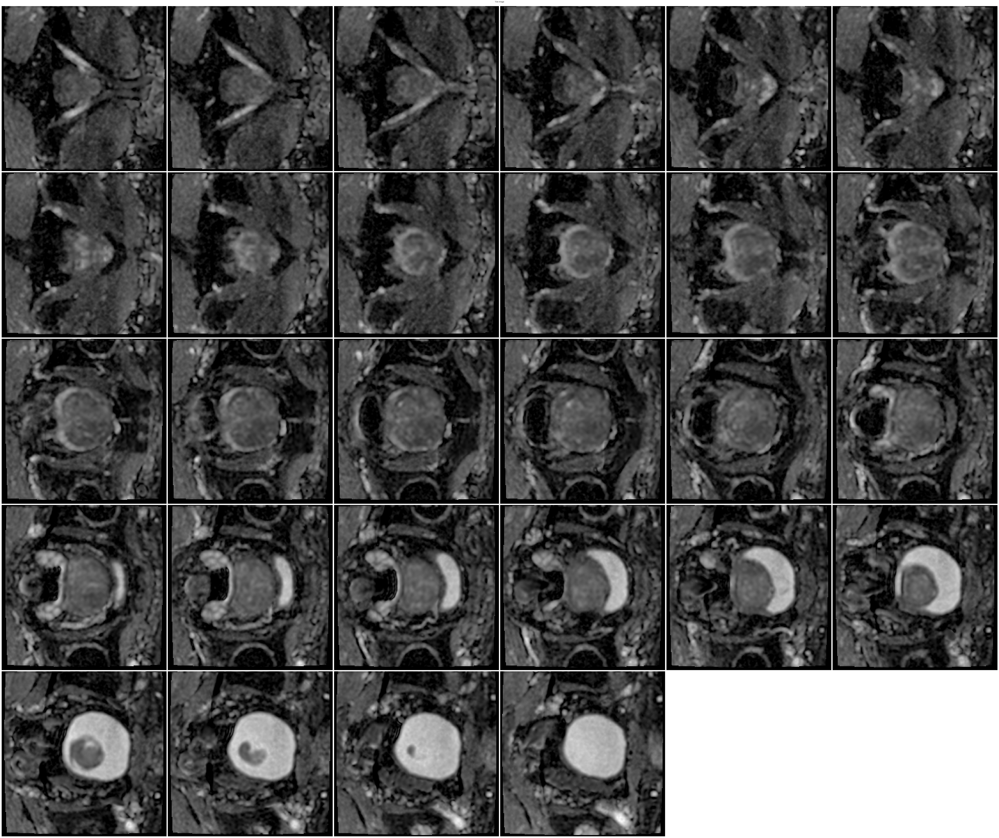

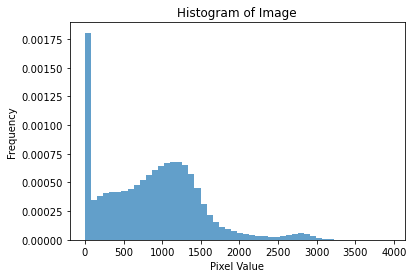

In [6]:
image=adc
print(image.shape)
monai.visualize.matshow3d(
    volume=image,
    fig=None, title="T2w image",
    figsize=(100, 100),
    every_n=1,
    frame_dim=-1,
    show=True,
    cmap="gray",
)
plt.show()

flatten_image = image.flatten()

# Convert the torch tensor to a NumPy array for plotting
numpy_array = flatten_image.numpy()

# Plot the histogram
plt.hist(numpy_array, bins=50, density=True, alpha=0.7)
plt.title('Histogram of Image')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')
plt.show()

In [9]:
dwi_protocols = {
    "ax dif  b1000": (1000, 0),
    "ax dif b1500": (1500, 0),
    "ax dif 2000": (2000, 0),
    "Ax DWI b50-800 PELVIS": (800, 50),
    "ax dif b1000": (1000, 0),
    "Ax DWI b2000": (2000, 0),
    "AX DWI B1000": (1000, 0),
    "AX DWI B800": (800, 0),
    "Ax DWI b1500": (1500, 0),
    "DWI_EPI_SPAIR_TRA B2000": (0, 2000),  # Pattern change
    "ax dif b1000": (1000, 0),
    "ax dif  b1500": (1500, 0),
    #"DW_Synthetic: AXI PELVIS DWI B50-800": None,  # Single channel
    "AXI PELVIS DWI B50-800": (50, 800),  # Pattern change
    "ax dif b1800": (1800, 0),
    "AX DWI b1500": (1500, 0),
    "Ax DWI b1500 FOV22 PRUEBA": (1500, 0),
    "ep2d_diff_tra_b0_b1000": (0, 1000),  # Pattern change
    "ax DWI b2000": (2000, 0)
}






df=pd.read_csv('/home/jaalzate/Tartaglia/Prostate_Tartaglia/New_Dataset/validation_dataset.csv')


source_path = "/mnt/ceib/datalake/FISABIO_datalake/p0042021/"



exp_name='creating_adc'


for i,row in tqdm(df.iterrows()):
    if row.can_calculate_adc:
        
        dwi_path=os.path.join(source_path, row.subject, row.session,'mim-mr',row.modality,row.image)
        b_values = dwi_protocols[row.SeriesDescription]

        #adc_map_name='_'.join(row.image.split('_')[:-1])+'_adc.nii.gz'
        adc_map_name=row.image.replace('dwi.nii.gz', 'mod-dwi_desc-calcADC_ADC.nii.gz')
        
        adc_path=os.path.join(source_path,'derivatives',exp_name,row.subject, row.session,'mim-mr','dwi')
        #print(adc_map_name)

        if os.path.exists(os.path.join(adc_path,adc_map_name)):
            img=monai.transforms.LoadImage()(os.path.join(adc_path,adc_map_name))
            print(img[0].shape)
            
            new_row_adc=pd.DataFrame({'subject':row.subject,
                                      'session':row.session,
                                      'modality':'dwi',
                                      'image':os.path.join('derivatives',exp_name,row.subject, row.session,'mim-mr','dwi',adc_map_name),
                                      'orientation':'ax',
                                      'sequence':'adc',
                                      'shape':str(list(img[0].shape)),
                                      'ProtocolName':f'adc_{b_values}',
                                      'SeriesDescription':f'adc_{b_values}',
                                      'usable':True,
                                      'can_calculate_adc':None}, index=[0])
            
            
            df=pd.concat([df.loc[0:i-1],  new_row_adc, df.loc[i:]], ignore_index=True)

0it [00:00, ?it/s]/opt/sci-soft/software/MONAI/1.2.0-foss-2021b-CUDA-11.7.0/lib/python3.9/site-packages/monai/utils/deprecate_utils.py:321: FutureWarning: monai.transforms.io.array LoadImage.__init__:image_only: Current default value of argument `image_only=False` has been deprecated since version 1.1. It will be changed to `image_only=True` in version 1.3.
  warn_deprecated(argname, msg, warning_category)
10it [00:00, 31.22it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 22])


14it [00:00, 22.25it/s]

torch.Size([256, 256, 34])
torch.Size([256, 256, 34])


17it [00:00, 22.37it/s]

torch.Size([256, 256, 34])


31it [00:01, 32.25it/s]

torch.Size([256, 256, 37])
torch.Size([224, 224, 37])
torch.Size([256, 256, 22])


35it [00:01, 28.73it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 33])


52it [00:01, 33.96it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 22])
torch.Size([256, 256, 28])


63it [00:01, 39.99it/s]

torch.Size([256, 256, 38])
torch.Size([256, 256, 38])


71it [00:02, 31.05it/s]

torch.Size([256, 256, 29])
torch.Size([256, 256, 24])
torch.Size([256, 256, 18])


79it [00:02, 29.79it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 25])


82it [00:02, 23.34it/s]

torch.Size([256, 256, 25])
torch.Size([256, 256, 20])
torch.Size([256, 256, 24])


89it [00:03, 25.84it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 26])


92it [00:03, 23.45it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 22])


99it [00:03, 30.05it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


103it [00:03, 21.98it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


107it [00:03, 21.36it/s]

torch.Size([256, 256, 30])
torch.Size([256, 256, 30])


113it [00:04, 18.52it/s]

torch.Size([256, 256, 30])
torch.Size([256, 256, 28])


115it [00:04, 16.33it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 23])
torch.Size([160, 160, 32])


129it [00:04, 33.99it/s]

torch.Size([256, 256, 22])
torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


137it [00:05, 24.24it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 21])


146it [00:05, 23.88it/s]

torch.Size([256, 256, 30])
torch.Size([256, 256, 30])
torch.Size([256, 256, 30])


152it [00:05, 21.81it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 22])


156it [00:05, 23.98it/s]

torch.Size([256, 256, 22])
torch.Size([256, 256, 28])


164it [00:06, 22.92it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 24])


171it [00:06, 23.92it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 22])
torch.Size([256, 256, 24])


174it [00:06, 21.59it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 23])


181it [00:07, 22.26it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


184it [00:07, 20.80it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


204it [00:07, 36.72it/s]

torch.Size([256, 256, 32])
torch.Size([256, 256, 22])
torch.Size([256, 256, 26])


216it [00:07, 47.19it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 37])
torch.Size([256, 256, 35])


237it [00:07, 65.42it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 22])
torch.Size([256, 256, 24])


244it [00:08, 40.68it/s]

torch.Size([256, 256, 36])
torch.Size([256, 256, 36])


250it [00:08, 40.15it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


255it [00:08, 34.15it/s]

torch.Size([256, 256, 31])
torch.Size([256, 256, 31])
torch.Size([256, 256, 31])


265it [00:09, 33.30it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 30])


269it [00:09, 29.98it/s]

torch.Size([256, 256, 30])
torch.Size([256, 256, 30])


278it [00:09, 27.73it/s]

torch.Size([256, 256, 30])
torch.Size([256, 256, 30])
torch.Size([256, 256, 30])


281it [00:09, 24.30it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 26])
torch.Size([256, 256, 26])


286it [00:10, 23.65it/s]

torch.Size([256, 256, 32])
torch.Size([256, 256, 32])


307it [00:10, 45.37it/s]

torch.Size([256, 256, 29])
torch.Size([256, 256, 24])


313it [00:10, 35.80it/s]

torch.Size([256, 256, 22])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


318it [00:10, 30.43it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 22])


327it [00:11, 31.26it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 22])
torch.Size([256, 256, 28])
torch.Size([256, 256, 30])


351it [00:11, 49.88it/s]

torch.Size([256, 256, 22])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


362it [00:11, 40.33it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 22])


367it [00:12, 33.87it/s]

torch.Size([256, 256, 30])
torch.Size([256, 256, 30])
torch.Size([256, 256, 26])


380it [00:12, 43.33it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 28])


385it [00:12, 37.64it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 28])


390it [00:12, 24.86it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


394it [00:13, 21.34it/s]

torch.Size([256, 256, 30])
torch.Size([256, 256, 30])


400it [00:13, 21.93it/s]

torch.Size([256, 256, 30])
torch.Size([256, 256, 26])


403it [00:13, 21.46it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 20])


414it [00:13, 35.05it/s]

torch.Size([256, 256, 35])
torch.Size([256, 256, 35])


422it [00:14, 27.01it/s]

torch.Size([256, 256, 35])
torch.Size([256, 256, 24])
torch.Size([256, 256, 22])
torch.Size([256, 256, 24])


436it [00:14, 38.29it/s]

torch.Size([256, 256, 35])
torch.Size([256, 256, 36])
torch.Size([256, 256, 36])
torch.Size([256, 256, 28])
torch.Size([256, 256, 36])


449it [00:14, 33.75it/s]

torch.Size([256, 256, 36])
torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


459it [00:15, 36.88it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 22])


464it [00:15, 34.64it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 22])
torch.Size([256, 256, 24])
torch.Size([256, 256, 26])


474it [00:15, 36.24it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 26])
torch.Size([256, 256, 28])
torch.Size([256, 256, 22])


484it [00:15, 37.49it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


494it [00:16, 49.07it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 26])
torch.Size([256, 256, 28])
torch.Size([256, 256, 24])


512it [00:16, 55.16it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 26])
torch.Size([256, 256, 26])


518it [00:16, 41.74it/s]

torch.Size([256, 256, 22])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


541it [00:16, 78.01it/s]

torch.Size([256, 256, 39])
torch.Size([256, 256, 28])


552it [00:16, 63.11it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 23])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


561it [00:17, 59.13it/s]

torch.Size([256, 256, 20])
torch.Size([256, 256, 26])
torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


569it [00:17, 48.02it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 26])


583it [00:17, 42.18it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 22])
torch.Size([256, 256, 20])


588it [00:17, 38.22it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


593it [00:18, 30.54it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 21])
torch.Size([256, 256, 32])


619it [00:18, 45.09it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


624it [00:18, 36.45it/s]

torch.Size([256, 256, 22])
torch.Size([256, 256, 26])
torch.Size([256, 256, 26])


629it [00:19, 32.45it/s]

torch.Size([256, 256, 25])
torch.Size([256, 256, 25])
torch.Size([256, 256, 25])


636it [00:19, 35.07it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 24])


645it [00:19, 33.01it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 26])
torch.Size([256, 256, 22])


654it [00:19, 31.24it/s]

torch.Size([256, 256, 32])
torch.Size([256, 256, 24])
torch.Size([256, 256, 32])


667it [00:20, 47.22it/s]

torch.Size([256, 256, 32])
torch.Size([256, 256, 23])
torch.Size([256, 256, 30])


677it [00:20, 35.72it/s]

torch.Size([256, 256, 30])
torch.Size([256, 256, 22])
torch.Size([256, 256, 22])
torch.Size([256, 256, 22])


697it [00:20, 62.69it/s]

torch.Size([256, 256, 35])
torch.Size([256, 256, 33])
torch.Size([256, 256, 28])


704it [00:20, 50.11it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 22])
torch.Size([256, 256, 24])


715it [00:21, 40.77it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 22])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


730it [00:21, 55.40it/s]

torch.Size([256, 256, 44])
torch.Size([256, 256, 30])
torch.Size([256, 256, 30])


742it [00:21, 47.97it/s]

torch.Size([256, 256, 30])
torch.Size([256, 256, 22])
torch.Size([256, 256, 22])
torch.Size([256, 256, 22])


751it [00:21, 53.16it/s]

torch.Size([256, 256, 23])
torch.Size([256, 256, 26])
torch.Size([256, 256, 26])


768it [00:22, 49.22it/s]

torch.Size([256, 256, 32])
torch.Size([256, 256, 24])
torch.Size([256, 256, 22])


786it [00:22, 61.51it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 26])
torch.Size([256, 256, 26])


798it [00:22, 70.59it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 24])
torch.Size([256, 256, 26])
torch.Size([256, 256, 26])


806it [00:22, 49.06it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 26])


818it [00:23, 42.24it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 26])
torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


825it [00:23, 46.46it/s]

torch.Size([256, 256, 21])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


836it [00:23, 38.08it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 22])
torch.Size([256, 256, 24])


851it [00:23, 48.09it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 22])


857it [00:23, 44.44it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 26])
torch.Size([256, 256, 26])


862it [00:24, 32.36it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


873it [00:24, 33.21it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 28])


877it [00:24, 28.86it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 31])


891it [00:24, 41.42it/s]

torch.Size([256, 256, 44])
torch.Size([256, 256, 35])
torch.Size([256, 256, 32])


915it [00:25, 49.57it/s]

torch.Size([256, 256, 23])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


920it [00:25, 41.73it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])


925it [00:25, 36.34it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 26])


935it [00:26, 29.12it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 26])
torch.Size([256, 256, 24])


946it [00:26, 37.42it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 22])


958it [00:26, 38.15it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 26])
torch.Size([256, 256, 22])


962it [00:26, 30.31it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


976it [00:27, 45.53it/s]

torch.Size([256, 256, 29])
torch.Size([256, 256, 29])
torch.Size([256, 256, 23])


981it [00:27, 39.88it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 26])
torch.Size([256, 256, 26])


986it [00:27, 27.50it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 26])
torch.Size([256, 256, 24])


996it [00:28, 27.93it/s]

torch.Size([256, 256, 24])
torch.Size([256, 256, 22])
torch.Size([256, 256, 26])


1000it [00:28, 26.28it/s]

torch.Size([256, 256, 26])
torch.Size([256, 256, 26])
torch.Size([256, 256, 31])


1014it [00:28, 40.04it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 22])
torch.Size([256, 256, 28])


1019it [00:28, 30.42it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 28])
torch.Size([256, 256, 26])


1027it [00:28, 34.89it/s]

torch.Size([256, 256, 22])
torch.Size([256, 256, 28])


1031it [00:29, 30.43it/s]

torch.Size([256, 256, 28])
torch.Size([256, 256, 24])
torch.Size([256, 256, 24])


1035it [00:29, 35.27it/s]

torch.Size([256, 256, 24])


In [10]:
df

,subject,session,modality,image,orientation,sequence,shape,ProtocolName,SeriesDescription,usable,can_calculate_adc
0,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-3_bp-p_vp-sa...,sag,T2w,"torch.Size([512, 512, 24])",sag T2 FRFSE,sag T2 FRFSE,True,False
1,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-6_bp-p_vp-ax...,ax,T2w,"torch.Size([512, 512, 28])",ax T2,ax T2,True,False
2,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-4_bp-p_vp-co...,cor,stir,"torch.Size([512, 512, 22])",CORONAL STIR FSE,CORONAL STIR FSE,True,False
3,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-8_bp-p_vp-ax...,ax,T2w,"torch.Size([512, 512, 28])",ax T2,ax T2,True,False
4,sub-000063,ses-000063,dwi,derivatives/creating_adc/sub-000063/ses-000063...,ax,adc,"[256, 256, 28]","adc_(1000, 0)","adc_(1000, 0)",True,None
...,...,...,...,...,...,...,...,...,...,...,...
1361,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-5_bp-a_vp-co...,cor,stir,"torch.Size([512, 512, 34])",CORONAL STIR FSE,CORONAL STIR FSE,True,False
1362,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-8_bp-a_vp-ax...,ax,T2w,"torch.Size([512, 512, 24])",ax T2,ax T2,True,False
1363,sub-000120,ses-000120,dwi,sub-000120_ses-000120_acq-bvalue_run-12_bp-a_v...,ax,dwi,"torch.Size([256, 256, 24, 2])",ax dif 2000,ax dif 2000,True,True
1364,sub-000120,ses-000120,dwi,sub-000120_ses-000120_acq-bvalue_run-10_bp-a_v...,ax,dwi,"torch.Size([256, 256, 24, 2])",ax dif b1000,ax dif b1000,True,True


In [11]:
#Read Variables DataFrame

df_var=pd.read_csv('/home/jaalzate/Tartaglia/Prostate_Tartaglia/Tartaglia_variables/variablesPT4_deps_ready_final_new_MIDS.tsv',sep='\t')
df_var_val=df_var[df_var.project=='p0042021']

df_var_val['label_XNAT_session'] = df_var_val['label_XNAT_session'].fillna(0)
df_var_val['label_XNAT_session'] = df_var_val['label_XNAT_session'].astype(int).astype(str).str.zfill(6)
df_var_val['label_MIDS_session'] = df_var_val['label_XNAT_session'].apply(lambda x: 'ses-'+x)

df_var_val['label_XNAT_subject'] = df_var_val['label_XNAT_subject'].fillna(0)
df_var_val['label_XNAT_subject'] = df_var_val['label_XNAT_subject'].astype(int).astype(str).str.zfill(6)
df_var_val['label_MIDS_subject'] = df_var_val['label_XNAT_subject'].apply(lambda x: 'sub-'+x)

/tmp/ipykernel_104858/3196381639.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_var_val['label_XNAT_session'] = df_var_val['label_XNAT_session'].fillna(0)
/tmp/ipykernel_104858/3196381639.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_var_val['label_XNAT_session'] = df_var_val['label_XNAT_session'].astype(int).astype(str).str.zfill(6)
/tmp/ipykernel_104858/3196381639.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

In [12]:
df_var_val

,project,dep,label_XNAT_subject,label_XNAT_session,ID_XNAT_subject,ID_XNAT_session,ED,AF,TB,TR,...,VP,PIR,csPC,F_nacimiento,F_RM,F_TACTO_RECTAL,F_PSA,F_csPC,label_MIDS_session,label_MIDS_subject
0,p0042021,7.0,000001,000001,XNAT3_S36738,XNAT3_E91781,77.0,NaN,1.0,NaN,...,48.472756,5.0,1.0,1934-10-02,2012-07-04,NaN,-136.0,-115.0,ses-000001,sub-000001
1,p0042021,2.0,000002,000002,XNAT3_S36739,XNAT3_E91782,57.0,NaN,NaN,NaN,...,26.282880,NaN,0.0,1958-08-10,2015-10-18,NaN,NaN,-51.0,ses-000002,sub-000002
2,p0042021,7.0,000003,000003,XNAT3_S36740,XNAT3_E91783,69.0,NaN,2.0,NaN,...,NaN,NaN,1.0,1945-01-02,2014-03-07,NaN,-42.0,-18.0,ses-000003,sub-000003
3,p0042021,7.0,000004,000004,XNAT3_S36741,XNAT3_E91784,52.0,NaN,2.0,NaN,...,NaN,NaN,1.0,1964-08-13,2017-03-24,NaN,-31.0,-63.0,ses-000004,sub-000004
4,p0042021,7.0,000005,000005,XNAT3_S36742,XNAT3_E91785,71.0,NaN,NaN,NaN,...,NaN,NaN,NaN,1944-02-16,2015-06-13,NaN,NaN,NaN,ses-000005,sub-000005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187,p0042021,2.0,000188,000188,XNAT3_S36925,XNAT3_E91968,63.0,NaN,NaN,NaN,...,47.090160,3.0,NaN,1950-11-21,2014-11-20,NaN,NaN,NaN,ses-000188,sub-000188
188,p0042021,5.0,000189,000189,XNAT3_S36926,XNAT3_E91969,77.0,NaN,NaN,NaN,...,48.000000,4.0,0.0,1933-07-14,2010-09-30,NaN,-88.0,-10.0,ses-000189,sub-000189
189,p0042021,2.0,000190,000190,XNAT3_S36927,XNAT3_E91970,76.0,NaN,NaN,NaN,...,110.295120,3.0,0.0,1938-11-04,2014-12-11,NaN,NaN,10.0,ses-000190,sub-000190
190,p0042021,17.0,000191,000191,XNAT3_S36928,XNAT3_E91971,66.0,NaN,NaN,NaN,...,31.478720,3.0,0.0,1948-06-18,2015-04-12,NaN,-15.0,1385.0,ses-000191,sub-000191


In [13]:
#Merge both Dataframes
df_merged=pd.merge(df,df_var_val,left_on='subject',right_on='label_MIDS_subject',how='left')
df_merged

,subject,session,modality,image,orientation,sequence,shape,ProtocolName,SeriesDescription,usable,...,VP,PIR,csPC,F_nacimiento,F_RM,F_TACTO_RECTAL,F_PSA,F_csPC,label_MIDS_session,label_MIDS_subject
0,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-3_bp-p_vp-sa...,sag,T2w,"torch.Size([512, 512, 24])",sag T2 FRFSE,sag T2 FRFSE,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
1,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-6_bp-p_vp-ax...,ax,T2w,"torch.Size([512, 512, 28])",ax T2,ax T2,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
2,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-4_bp-p_vp-co...,cor,stir,"torch.Size([512, 512, 22])",CORONAL STIR FSE,CORONAL STIR FSE,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
3,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-8_bp-p_vp-ax...,ax,T2w,"torch.Size([512, 512, 28])",ax T2,ax T2,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
4,sub-000063,ses-000063,dwi,derivatives/creating_adc/sub-000063/ses-000063...,ax,adc,"[256, 256, 28]","adc_(1000, 0)","adc_(1000, 0)",True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1361,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-5_bp-a_vp-co...,cor,stir,"torch.Size([512, 512, 34])",CORONAL STIR FSE,CORONAL STIR FSE,True,...,34.000000,4.0,1.0,1945-06-17,2014-09-24,NaN,-144.0,-109.0,ses-000120,sub-000120
1362,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-8_bp-a_vp-ax...,ax,T2w,"torch.Size([512, 512, 24])",ax T2,ax T2,True,...,34.000000,4.0,1.0,1945-06-17,2014-09-24,NaN,-144.0,-109.0,ses-000120,sub-000120
1363,sub-000120,ses-000120,dwi,sub-000120_ses-000120_acq-bvalue_run-12_bp-a_v...,ax,dwi,"torch.Size([256, 256, 24, 2])",ax dif 2000,ax dif 2000,True,...,34.000000,4.0,1.0,1945-06-17,2014-09-24,NaN,-144.0,-109.0,ses-000120,sub-000120
1364,sub-000120,ses-000120,dwi,sub-000120_ses-000120_acq-bvalue_run-10_bp-a_v...,ax,dwi,"torch.Size([256, 256, 24, 2])",ax dif b1000,ax dif b1000,True,...,34.000000,4.0,1.0,1945-06-17,2014-09-24,NaN,-144.0,-109.0,ses-000120,sub-000120


In [14]:
df_merged.sequence.value_counts()

sequence
T2w     498
adc     437
dwi     341
stir     90
Name: count, dtype: int64

In [15]:
df_merged

,subject,session,modality,image,orientation,sequence,shape,ProtocolName,SeriesDescription,usable,...,VP,PIR,csPC,F_nacimiento,F_RM,F_TACTO_RECTAL,F_PSA,F_csPC,label_MIDS_session,label_MIDS_subject
0,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-3_bp-p_vp-sa...,sag,T2w,"torch.Size([512, 512, 24])",sag T2 FRFSE,sag T2 FRFSE,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
1,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-6_bp-p_vp-ax...,ax,T2w,"torch.Size([512, 512, 28])",ax T2,ax T2,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
2,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-4_bp-p_vp-co...,cor,stir,"torch.Size([512, 512, 22])",CORONAL STIR FSE,CORONAL STIR FSE,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
3,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-8_bp-p_vp-ax...,ax,T2w,"torch.Size([512, 512, 28])",ax T2,ax T2,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
4,sub-000063,ses-000063,dwi,derivatives/creating_adc/sub-000063/ses-000063...,ax,adc,"[256, 256, 28]","adc_(1000, 0)","adc_(1000, 0)",True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1361,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-5_bp-a_vp-co...,cor,stir,"torch.Size([512, 512, 34])",CORONAL STIR FSE,CORONAL STIR FSE,True,...,34.000000,4.0,1.0,1945-06-17,2014-09-24,NaN,-144.0,-109.0,ses-000120,sub-000120
1362,sub-000120,ses-000120,anat,sub-000120_ses-000120_acq-fse_run-8_bp-a_vp-ax...,ax,T2w,"torch.Size([512, 512, 24])",ax T2,ax T2,True,...,34.000000,4.0,1.0,1945-06-17,2014-09-24,NaN,-144.0,-109.0,ses-000120,sub-000120
1363,sub-000120,ses-000120,dwi,sub-000120_ses-000120_acq-bvalue_run-12_bp-a_v...,ax,dwi,"torch.Size([256, 256, 24, 2])",ax dif 2000,ax dif 2000,True,...,34.000000,4.0,1.0,1945-06-17,2014-09-24,NaN,-144.0,-109.0,ses-000120,sub-000120
1364,sub-000120,ses-000120,dwi,sub-000120_ses-000120_acq-bvalue_run-10_bp-a_v...,ax,dwi,"torch.Size([256, 256, 24, 2])",ax dif b1000,ax dif b1000,True,...,34.000000,4.0,1.0,1945-06-17,2014-09-24,NaN,-144.0,-109.0,ses-000120,sub-000120


In [16]:

# Filter the original dataset to consider only usable images
usable_df = df_merged[df_merged['usable']]

# Group by 'subject' and 'session' to identify the unique sequences for each combination
sequences_per_patient_session_usable = usable_df.groupby(['subject', 'session'])['sequence'].unique().reset_index()
sequences_per_patient_session_usable.rename(columns={'sequence': 'sequences_list'}, inplace=True)

# Create columns to indicate if the patient-session combination has 'adc', 'dwi', and 'T2w' sequences
sequences_per_patient_session_usable['has_adc'] = sequences_per_patient_session_usable['sequences_list'].apply(lambda x: 'adc' in x)
sequences_per_patient_session_usable['has_dwi'] = sequences_per_patient_session_usable['sequences_list'].apply(lambda x: 'dwi' in x)
sequences_per_patient_session_usable['has_T2w'] = sequences_per_patient_session_usable['sequences_list'].apply(lambda x: 'T2w' in x)


# Add a column to indicate if all three sequences ('adc', 'dwi', 'T2w') are present
sequences_per_patient_session_usable['has_all_sequences'] = sequences_per_patient_session_usable.apply(
    lambda row: row['has_adc'] and row['has_dwi'] and row['has_T2w'], axis=1)

sequences_per_patient_session_usable.head()

sequences_per_patient_session_usable['csPC']=pd.merge(sequences_per_patient_session_usable,df_var_val,left_on='subject',right_on='label_MIDS_subject',how='left')['csPC']

In [17]:
sequences_per_patient_session_usable[sequences_per_patient_session_usable['has_all_sequences']==True].csPC.value_counts()

csPC
0.0    46
1.0    37
0.5     8
Name: count, dtype: int64

In [18]:
sequences_per_patient_session_usable['has_all_sequences'].sum()

123

In [19]:
sequences_per_patient_session_usable[sequences_per_patient_session_usable['has_all_sequences']==True]

,subject,session,sequences_list,has_adc,has_dwi,has_T2w,has_all_sequences,csPC
0,sub-000003,ses-000003,"[adc, T2w, stir, dwi]",True,True,True,True,1.0
1,sub-000004,ses-000004,"[adc, T2w, stir, dwi]",True,True,True,True,1.0
2,sub-000005,ses-000005,"[adc, T2w, stir, dwi]",True,True,True,True,NaN
3,sub-000006,ses-000006,"[adc, stir, T2w, dwi]",True,True,True,True,NaN
4,sub-000008,ses-000008,"[adc, T2w, stir, dwi]",True,True,True,True,NaN
...,...,...,...,...,...,...,...,...
147,sub-000183,ses-000183,"[adc, T2w, dwi]",True,True,True,True,0.0
148,sub-000184,ses-000184,"[adc, T2w, dwi]",True,True,True,True,1.0
150,sub-000186,ses-000186,"[adc, T2w, dwi]",True,True,True,True,0.0
152,sub-000189,ses-000189,"[adc, T2w, dwi]",True,True,True,True,0.0


In [22]:
df_merged[df_merged.subject=='sub-000063']

,subject,session,modality,image,orientation,sequence,shape,ProtocolName,SeriesDescription,usable,...,VP,PIR,csPC,F_nacimiento,F_RM,F_TACTO_RECTAL,F_PSA,F_csPC,label_MIDS_session,label_MIDS_subject
0,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-3_bp-p_vp-sa...,sag,T2w,"torch.Size([512, 512, 24])",sag T2 FRFSE,sag T2 FRFSE,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
1,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-6_bp-p_vp-ax...,ax,T2w,"torch.Size([512, 512, 28])",ax T2,ax T2,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
2,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-4_bp-p_vp-co...,cor,stir,"torch.Size([512, 512, 22])",CORONAL STIR FSE,CORONAL STIR FSE,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
3,sub-000063,ses-000063,anat,sub-000063_ses-000063_acq-fse_run-8_bp-p_vp-ax...,ax,T2w,"torch.Size([512, 512, 28])",ax T2,ax T2,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
4,sub-000063,ses-000063,dwi,derivatives/creating_adc/sub-000063/ses-000063...,ax,adc,"[256, 256, 28]","adc_(1000, 0)","adc_(1000, 0)",True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
5,sub-000063,ses-000063,dwi,derivatives/creating_adc/sub-000063/ses-000063...,ax,adc,"[256, 256, 28]","adc_(1500, 0)","adc_(1500, 0)",True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
6,sub-000063,ses-000063,dwi,derivatives/creating_adc/sub-000063/ses-000063...,ax,adc,"[256, 256, 22]","adc_(2000, 0)","adc_(2000, 0)",True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
7,sub-000063,ses-000063,dwi,sub-000063_ses-000063_acq-bvalue_run-13_bp-p_v...,ax,dwi,"torch.Size([256, 256, 28, 2])",ax dif b1000,ax dif b1000,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
8,sub-000063,ses-000063,dwi,sub-000063_ses-000063_acq-bvalue_run-14_bp-p_v...,ax,dwi,"torch.Size([256, 256, 28, 2])",ax dif b1500,ax dif b1500,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063
9,sub-000063,ses-000063,dwi,sub-000063_ses-000063_acq-bvalue_run-15_bp-p_v...,ax,dwi,"torch.Size([256, 256, 22, 2])",ax dif 2000,ax dif 2000,True,...,105.698736,3.0,0.0,1947-04-05,2016-07-07,NaN,NaN,14.0,ses-000063,sub-000063


In [27]:
df_merged.to_csv('/home/jaalzate/Tartaglia/Prostate_Tartaglia/New_Dataset/validation_dataset_complete.csv',index=False)

In [23]:

source_path = "/mnt/ceib/datalake/FISABIO_datalake/p0042021"
sub_df=df_merged[df_merged.subject=='sub-000063']
t2w=monai.transforms.LoadImage()(os.path.join(source_path, sub_df.subject[1], sub_df.session[1],'mim-mr',sub_df.modality[1],sub_df.image[1]))[0]
dwi=monai.transforms.LoadImage()(os.path.join(source_path, sub_df.subject[7], sub_df.session[7],'mim-mr',sub_df.modality[7],sub_df.image[7]))[0][:,:,:,0]
adc=monai.transforms.LoadImage()(os.path.join(source_path, sub_df.image[4]))[0]
#adc_1=monai.transforms.LoadImage()(os.path.join(source_path, sub_df.subject[1052], sub_df.session[1052],'mim-mr',sub_df.modality[1052],sub_df.image[1052]))[0]


/opt/sci-soft/software/MONAI/1.2.0-foss-2021b-CUDA-11.7.0/lib/python3.9/site-packages/monai/utils/deprecate_utils.py:321: FutureWarning: monai.transforms.io.array LoadImage.__init__:image_only: Current default value of argument `image_only=False` has been deprecated since version 1.1. It will be changed to `image_only=True` in version 1.3.
  warn_deprecated(argname, msg, warning_category)


torch.Size([512, 512, 28])


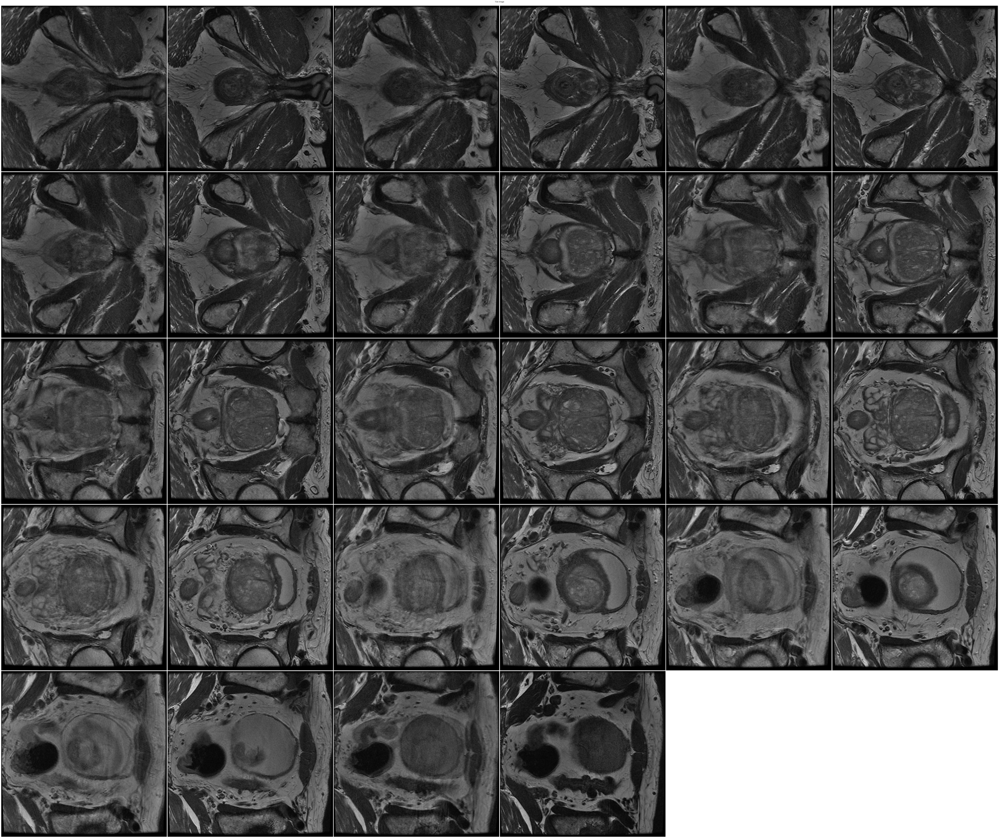

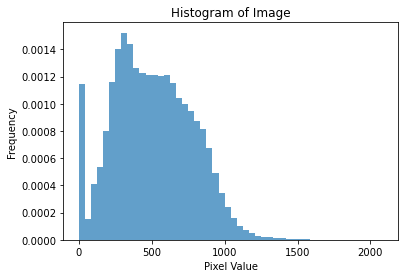

In [24]:
image=t2w
print(image.shape)
monai.visualize.matshow3d(
    volume=image,
    fig=None, title="T2w image",
    figsize=(100, 100),
    every_n=1,
    frame_dim=-1,
    show=True,
    cmap="gray",
)
plt.show()

flatten_image = image.flatten()

# Convert the torch tensor to a NumPy array for plotting
numpy_array = flatten_image.numpy()

# Plot the histogram
plt.hist(numpy_array, bins=50, density=True, alpha=0.7)
plt.title('Histogram of Image')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')
plt.show()

torch.Size([256, 256, 28])


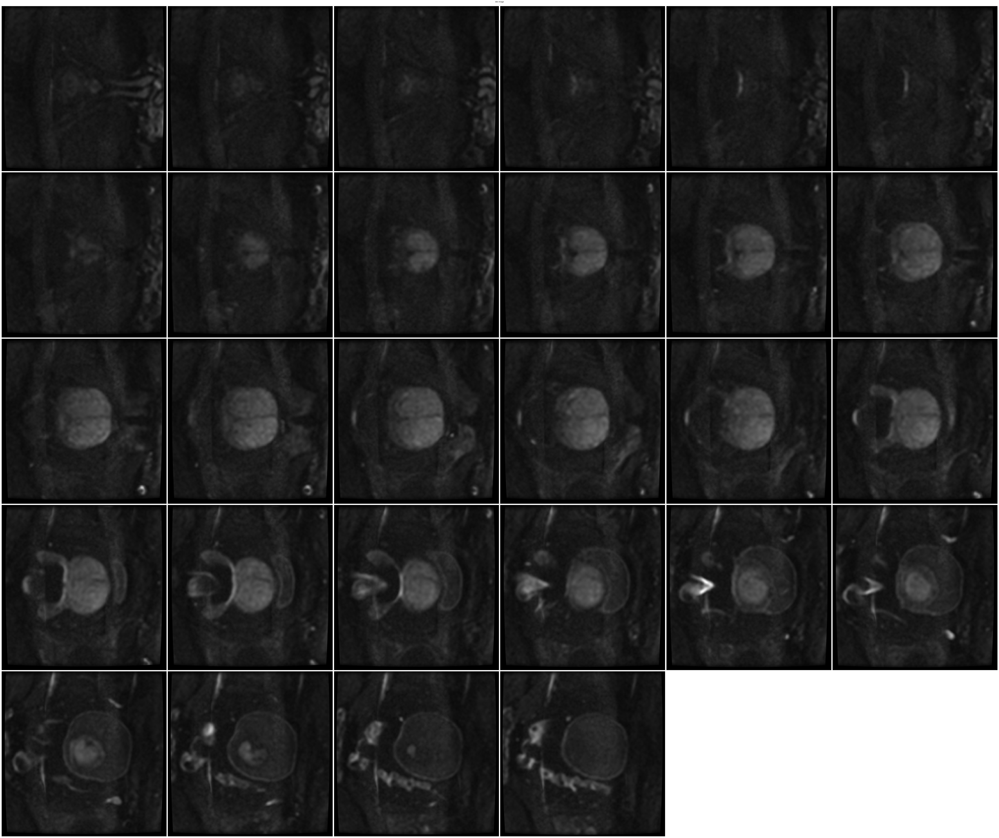

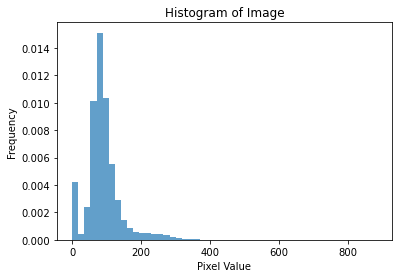

In [25]:
image=dwi
print(image.shape)
monai.visualize.matshow3d(
    volume=image,
    fig=None, title="dwi image",
    figsize=(100, 100),
    every_n=1,
    frame_dim=-1,
    show=True,
    cmap="gray",
)
plt.show()

flatten_image = image.flatten()

# Convert the torch tensor to a NumPy array for plotting
numpy_array = flatten_image.numpy()

# Plot the histogram
plt.hist(numpy_array, bins=50, density=True, alpha=0.7)
plt.title('Histogram of Image')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')
plt.show()

torch.Size([256, 256, 28])


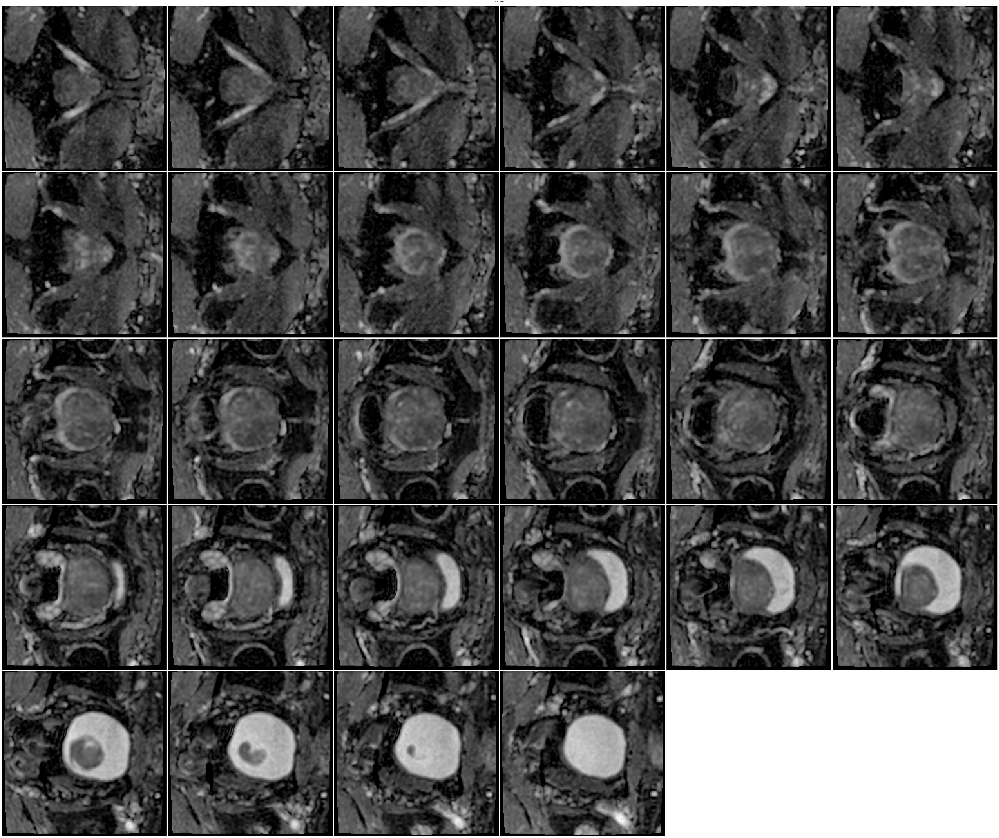

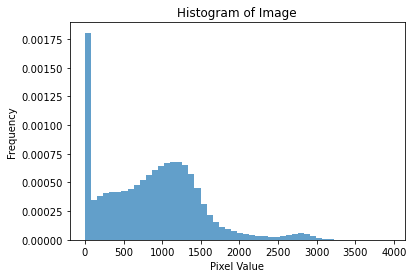

In [26]:
image=adc
print(image.shape)
monai.visualize.matshow3d(
    volume=image,
    fig=None, title="ADC image",
    figsize=(100, 100),
    every_n=1,
    frame_dim=-1,
    show=True,
    cmap="gray",
)
plt.show()

flatten_image = image.flatten()

# Convert the torch tensor to a NumPy array for plotting
numpy_array = flatten_image.numpy()

# Plot the histogram
plt.hist(numpy_array, bins=50, density=True, alpha=0.7)
plt.title('Histogram of Image')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')
plt.show()

torch.Size([256, 256, 37])


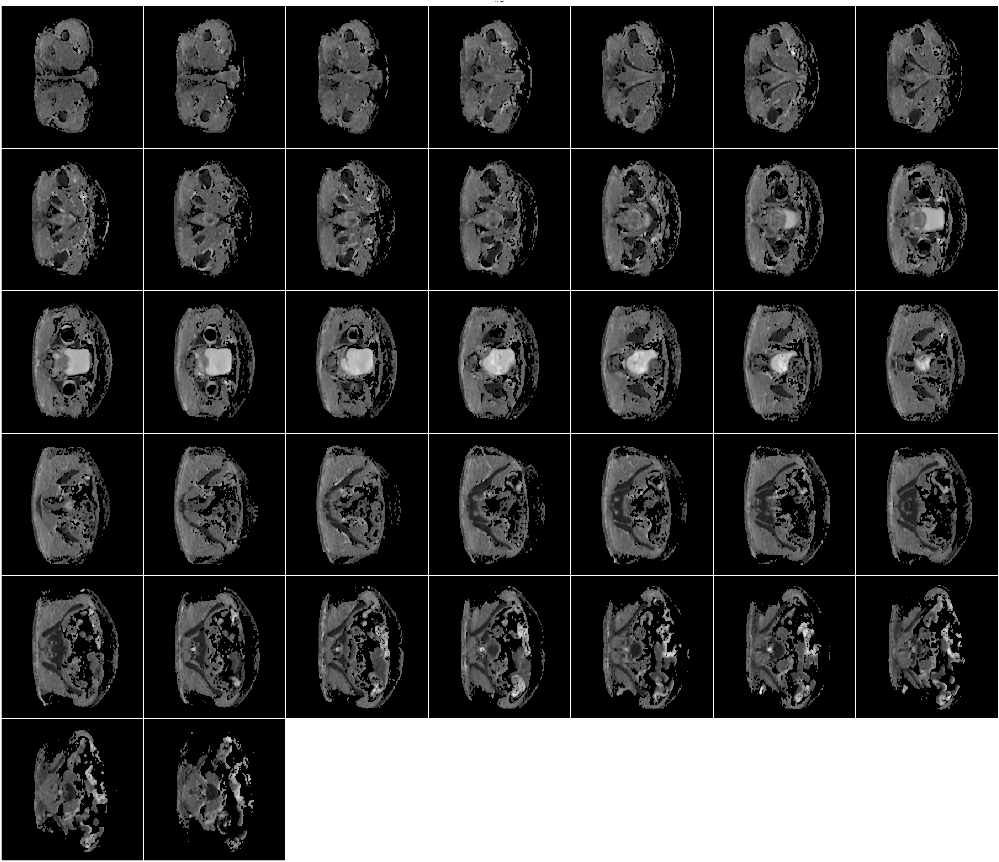

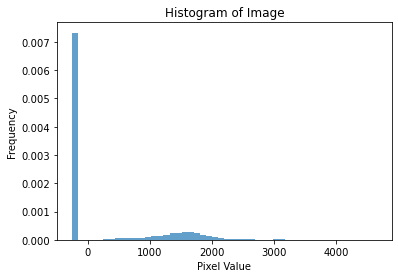

In [226]:
image=adc_1
print(image.shape)
monai.visualize.matshow3d(
    volume=image,
    fig=None, title="ADC image",
    figsize=(100, 100),
    every_n=1,
    frame_dim=-1,
    show=True,
    cmap="gray",
)
plt.show()

flatten_image = image.flatten()

# Convert the torch tensor to a NumPy array for plotting
numpy_array = flatten_image.numpy()

# Plot the histogram
plt.hist(numpy_array, bins=50, density=True, alpha=0.7)
plt.title('Histogram of Image')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')
plt.show()

# Borrar

In [227]:
df=pd.read_csv('/home/jaalzate/Tartaglia/Prostate_Tartaglia/codes/partition_1.csv')

In [235]:
groupby = df.groupby('partition')

In [237]:
groupby.get_group('tr')['case_csPCa'].value_counts()

case_csPCa
NO     643
YES    253
Name: count, dtype: int64

In [238]:
groupby.get_group('tr')['label'].value_counts()

label
0    643
1    253
Name: count, dtype: int64

In [239]:
groupby.get_group('dev')['case_csPCa'].value_counts()


case_csPCa
NO     214
YES     85
Name: count, dtype: int64

In [241]:
groupby.get_group('dev')['label'].value_counts()


label
0    214
1     85
Name: count, dtype: int64

In [240]:
groupby.get_group('test')['case_csPCa'].value_counts()

case_csPCa
NO     214
YES     84
Name: count, dtype: int64

In [242]:
groupby.get_group('test')['label'].value_counts()


label
0    214
1     84
Name: count, dtype: int64